# 2022 Boston Crime Rates
Author: Sonny Mei <br>
Date: October 8, 2023

![Image Of A Crime Site In Boston](../Images/Boston_Crime.jpg)

**Introduction:**

As a long-time Boston resident, I was interested in viewing the types of crime rates that occured in Boston.The purpose of this project is to analyze Boston crimes in 2022, along with gaining more experience using Jupyter Notebook.

Objective:
1) Perform an initial analysis for the 2022 Boston crime rate dataset.
2) Transition to Tableau or Power BI to create an interactive map, including crime rates from 2015 to present

Questions:
1) What are the different types of crimes that occured in 2022?
2) How do these crimes look throughout the year?
3) Display a map showing the crimes that took place in different areas of Boston.

**Data Loading and Preprocessing:**

Below are the libraries used for data analysis and data visualization.

In [1]:
# Plotting and Data Manipulation
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np

# Creating a visual map of crimes
import folium
from folium.plugins import MarkerCluster

The 2022 crime incident reports have been obtained from the City of Boston's open data hub, "Analyze Boston". Since both columns OFFENSE_CODE_GROUP and UCR_PART report 'NaN', these columns were dropped.

In [2]:
file_path = '../Data/2022_Boston_Crimes.csv'

# Resolve warning using dtype:
## DtypeWarning: Columns (0) have mixed types. Specify dtype option on import or set low_memory=False.
df = pd.read_csv(file_path, dtype={'INCIDENT_NUMBER': 'str'})

# Dropping columns that are NaN.
columns_to_drop = ['OFFENSE_CODE_GROUP', 'UCR_PART']
df = df.drop(columns=columns_to_drop)

The Boston Crime Rates dataset contains useful columns, such as the date an incident occured and the location.

In [3]:
df

,INCIDENT_NUMBER,OFFENSE_CODE,OFFENSE_DESCRIPTION,DISTRICT,REPORTING_AREA,SHOOTING,OCCURRED_ON_DATE,YEAR,MONTH,DAY_OF_WEEK,HOUR,STREET,Lat,Long,Location
0,222076257,619,LARCENY ALL OTHERS,D4,167,0,2022-01-01 00:00:00,2022,1,Saturday,0,HARRISON AVE,42.339542,-71.069409,"(42.33954198983014, -71.06940876967543)"
1,222053099,2670,HARASSMENT/ CRIMINAL HARASSMENT,A7,,0,2022-01-01 00:00:00,2022,1,Saturday,0,BENNINGTON ST,42.377246,-71.032597,"(42.37724638479816, -71.0325970804128)"
2,222039411,3201,PROPERTY - LOST/ MISSING,D14,778,0,2022-01-01 00:00:00,2022,1,Saturday,0,WASHINGTON ST,42.349056,-71.150498,"(42.34905600030506, -71.15049849975023)"
3,222011090,3201,PROPERTY - LOST/ MISSING,B3,465,0,2022-01-01 00:00:00,2022,1,Saturday,0,BLUE HILL AVE,42.284826,-71.091374,"(42.28482576580488, -71.09137368938802)"
4,222062685,3201,PROPERTY - LOST/ MISSING,B3,465,0,2022-01-01 00:00:00,2022,1,Saturday,0,BLUE HILL AVE,42.284826,-71.091374,"(42.28482576580488, -71.09137368938802)"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
73847,232000091,1402,VANDALISM,A1,66,0,2022-12-31 23:30:00,2022,12,Saturday,23,CHARLES ST,42.359790,-71.070782,"(42.35979037458775, -71.07078234449541)"
73848,232000002,3831,M/V - LEAVING SCENE - PROPERTY DAMAGE,C11,,0,2022-12-31 23:37:00,2022,12,Saturday,23,COLUMBIA RD,42.319593,-71.062607,"(42.31959298334654, -71.06260699634272)"
73849,232000140,619,LARCENY ALL OTHERS,D14,778,0,2022-12-31 23:45:00,2022,12,Saturday,23,WASHINGTON ST,42.349056,-71.150498,"(42.34905600030506, -71.15049849975023)"
73850,232000315,3201,PROPERTY - LOST/ MISSING,D4,167,0,2022-12-31 23:50:00,2022,12,Saturday,23,HARRISON AVENUE,NaN,NaN,NaN


**Data Visualization:**

As mentioned before, the entire rows associated with the OFFENSE_CODE_GROUP column is NaN. Thus, I decided group crimes based on the following:
1) Violent Crimes
2) Sexual Offenses
3) Property Crimes
4) Vehicle Crimes
5) White-Collar Crimes
6) Substance Abuse
7) Crimes Involving Minors
8) Public Order Crimes
9) Investigation
10) Sick-Related Crimes
11) Missing Person
12) Suicide or Sudden Death
13) Others

I manually viewed each crime and combined crimes base on similar words.

In [4]:
# Define the grouped_categories dictionary
grouped_categories = {
    'Violent Crimes': ['Murder', 'Killing', 'Manslaughter', 'Weapon', 'Firearm', 'Robbery', 'Assault', 'Stalking', 'Kidnapping', 'THREATS TO DO BODILY HARM'],
    'Sexual Offenses': ['Rape', 'Prostitution', 'Indecent', 'Lewdness', 'Sex Offense', 'Failure To Register As A Sex Offender'],
    'Property Crimes': ['Burglary', 'Larceny', 'Arson', 'Stolen Property', 'Vandalism', 'Graffiti', 'Property', 'Trespassing', 'Possession Of Burglarious Tools', 'Explosives - Possession or Use'],
    'Vehicle Crimes': ['Auto Theft', 'Operating under', 'Parking Violation', 'Violation of Auto Law', 'M/V', 'VAL', 'MOTOR VEHICLE', 'BREAKING AND ENTERING (B&E) MOTOR VEHICLE', 'BREAKING AND ENTERING (B&E) MOTOR VEHICLE (NO PROPERTY STOLEN)', 'RECOVERED - MV RECOVERED IN BOSTON'],
    'White-Collar Crimes': ['Forgery', 'Counterfeiting', 'Uttering', 'Confidence Games', 'Fraud', 'Embezzlement', 'Gambling', 'Extortion Or Blackmail'],
    'Substance Abuse': ['Drugs', 'Liquor', 'Alcohol', 'DRUNKENNESS'],
    'Crimes Involving Minors': ['Child Abandonment', 'Child Endangerment', 'Child Abuse', 'Contributing to Delinquency of a Minor', 'CHINS', 'Truancy'],
    'Public Order Crimes': ['Affray', 'Disorderly', 'Disturbing the Peace', 'Verbal Dispute', 'Gathering Causing Annoyance', 'Noisy Party', 'Demonstrations/Riot', 'Demonstrations / Riot', 'Dangerous Or Hazardous Condition', 'Bomb Threat', 'Violation - City Ordinance', 'Criminal Harassment', 'Criminal Harrassment', 'Evading Fare'],
    'Investigation': ['Investigate', 'INVESTIGATION'],
    'Sick-Related Crimes': ['Sick'],
    'Missing Person': ['Missing Person'],
    'Suicide or Sudden Death': ['SUDDEN DEATH', 'SUICIDE'],
    'Others': ['Other Offense', 'Aircraft Incidents', 'Animal', 'Ballistics Evidence', 'Explosives - Turned In or Found', 'Fire Report', 'Missing Person', 'Prisoner', 'Suicide', 'Sudden Death', 'Sick', 'Threats To Do Bodily Harm', 'Death Investigation', 'Investigate Person', 'Fugitive From Justice', 'Towed Motor Vehicle', 'License Premise Violation', 'Landlord - Tenant Service', 'Service To Other PD Outside Of MA.', 'Recovered - MV Recovered In Boston (Stolen Out...)', 'Search Warrant', 'Warrant Arrest', 'Harbor Incident / Violation', 'Harbor Incidents', 'Intimidating Witness', 'Protective Custody / Safekeeping', 'Safekeeping', 'Obscene Phone Calls', 'RECOVERED - MV RECOVERED IN BOSTON (STOLEN OUTSIDE BOSTON)']
}

# Create a new column 'Category' based on 'OFFENSE_DESCRIPTION' column
def categorize_name(name):
    if isinstance(name, str):
        name = name.upper()  # Convert the input name to uppercase
        for k, v in grouped_categories.items():
            if any(keyword.upper() in name for keyword in v):
                v
                return k
    return 'Others'

df['Category'] = df['OFFENSE_DESCRIPTION'].apply(categorize_name)

df[['OFFENSE_DESCRIPTION', 'Category']]

,OFFENSE_DESCRIPTION,Category
0,LARCENY ALL OTHERS,Property Crimes
1,HARASSMENT/ CRIMINAL HARASSMENT,Public Order Crimes
2,PROPERTY - LOST/ MISSING,Property Crimes
3,PROPERTY - LOST/ MISSING,Property Crimes
4,PROPERTY - LOST/ MISSING,Property Crimes
...,...,...
73847,VANDALISM,Property Crimes
73848,M/V - LEAVING SCENE - PROPERTY DAMAGE,Property Crimes
73849,LARCENY ALL OTHERS,Property Crimes
73850,PROPERTY - LOST/ MISSING,Property Crimes


A bar graph displays the crimes in each category.

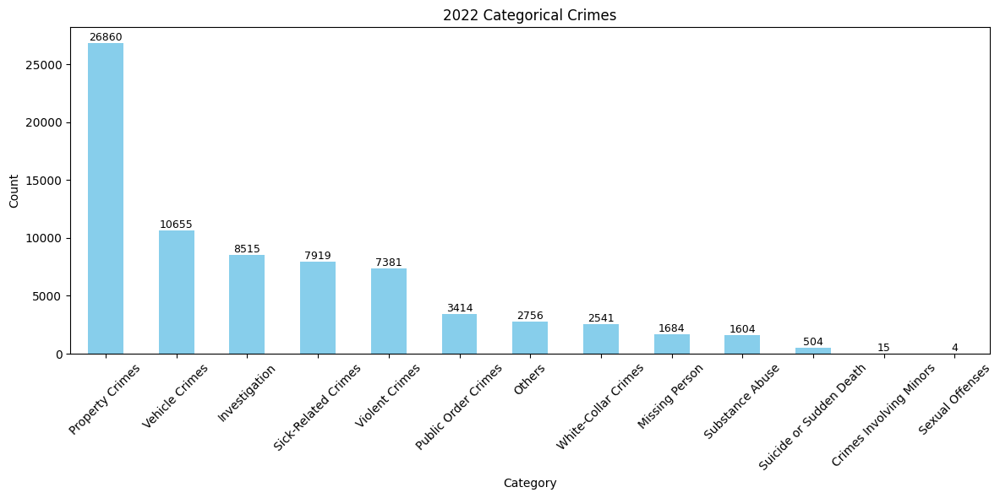

In [5]:
# Count the occurrences of each category
category_counts = df['Category'].value_counts()

# Create a bar plot
plt.figure(figsize=(12, 6))
ax = category_counts.plot(kind='bar', color='skyblue')
plt.title('2022 Categorical Crimes')
plt.xlabel('Category')
plt.ylabel('Count')
plt.xticks(rotation=45)  # Rotate x-axis labels for readability

# Add total count labels on top of each bar
for i, v in enumerate(category_counts):
    ax.text(i, v + 10, str(v), ha='center', va='bottom', fontsize=9)

plt.tight_layout()

# Show the plot
plt.show()

The table below lists the crimes I labelled as 'Others' which does not fall into a particular category. Some examples include 'FIRE REPORT' or 'ANIMAL INCIDENTS'.

In [6]:
# Filter for records where 'Category' is 'Others'
other_crimes = df[df['Category'] == 'Others']

# Group by 'OFFENSE_DESCRIPTION' and count occurrences
other_crimes_counts = other_crimes.groupby('OFFENSE_DESCRIPTION').size().reset_index(name='Count')

# Sort by count in descending order (most to least)
other_crimes_counts = other_crimes_counts.sort_values(by='Count', ascending=False)

# Create a title string
title = "Other Crimes and Their Counts"

# Print the title
print(title)

# Display the table
other_crimes_counts

Other Crimes and Their Counts


,OFFENSE_DESCRIPTION,Count
5,FIRE REPORT,442
19,WARRANT ARREST - OUTSIDE OF BOSTON WARRANT,406
11,LICENSE PREMISE VIOLATION,353
10,LANDLORD - TENANT,344
3,BALLISTICS EVIDENCE/FOUND,299
17,SERVICE TO OTHER AGENCY,286
2,"ANIMAL INCIDENTS (DOG BITES, LOST DOG, ETC)",195
16,SEARCH WARRANT,123
8,HARBOR INCIDENT / VIOLATION,64
18,WARRANT ARREST - BOSTON WARRANT (MUST BE SUPPL...,57


Below displays crime rates throughout the year. The summer season contains the highest amount of crime rates.

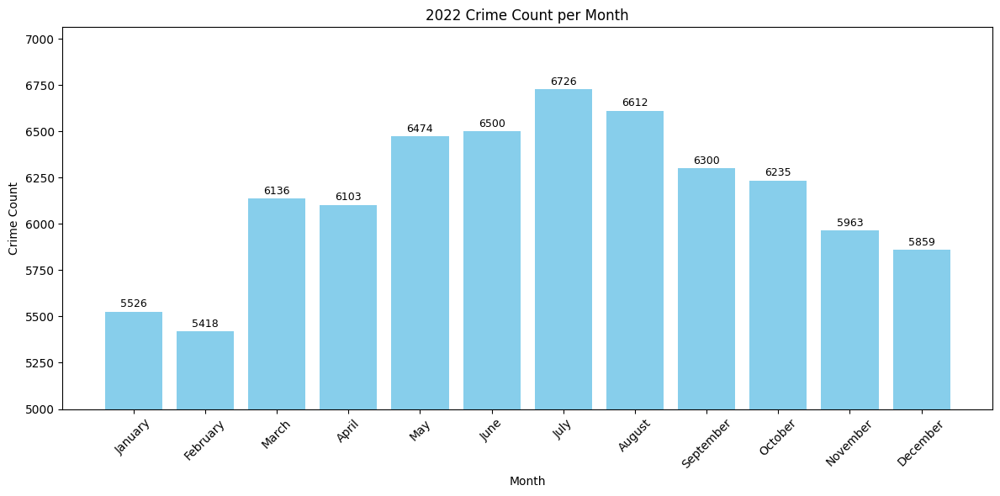

In [7]:
# Count the number of crimes in each month
monthly_crime_counts = df['MONTH'].value_counts().reset_index()
monthly_crime_counts.columns = ['MONTH', 'Crime Count']
monthly_crime_counts = monthly_crime_counts.sort_values(by='MONTH')

# Define a dictionary to map numeric month values to month names
month_names = {
    1: 'January',
    2: 'February',
    3: 'March',
    4: 'April',
    5: 'May',
    6: 'June',
    7: 'July',
    8: 'August',
    9: 'September',
    10: 'October',
    11: 'November',
    12: 'December'
}

# Map numeric month values to month names
monthly_crime_counts['MONTH'] = monthly_crime_counts['MONTH'].map(month_names)

# Set the figure size
plt.figure(figsize=(12, 6))

# Use the custom month order for x-axis labels
ax = plt.bar(monthly_crime_counts['MONTH'], monthly_crime_counts['Crime Count'], color='skyblue')
plt.title('2022 Crime Count per Month')
plt.xlabel('Month')
plt.ylabel('Crime Count')
plt.xticks(rotation=45)  # Rotate x-axis labels for readability

# Add total count labels on top of each bar
for i, v in enumerate(monthly_crime_counts['Crime Count']):
    plt.text(i, v + 10, str(v), ha='center', va='bottom', fontsize=9)

# Set the y-axis minimum to 4000
plt.ylim(5000)

plt.tight_layout()

# Show the plot
plt.show()

Below displays  the same bar graph but color-coded by category. Each crime category is viewed as relatively the same for each month.

<Figure size 1200x600 with 0 Axes>

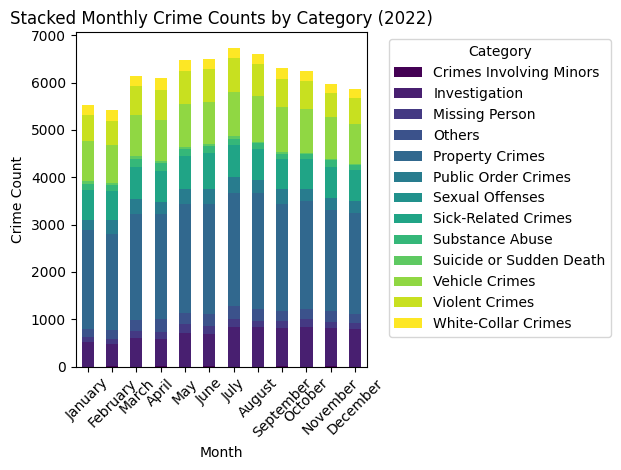

In [8]:
# Create a pivot table to count crimes in each month by category
pivot_table = df.pivot_table(index='MONTH', columns='Category', values='INCIDENT_NUMBER', aggfunc='count', fill_value=0)

# Define a dictionary to map numeric month values to month names
month_names = {
    1: 'January',
    2: 'February',
    3: 'March',
    4: 'April',
    5: 'May',
    6: 'June',
    7: 'July',
    8: 'August',
    9: 'September',
    10: 'October',
    11: 'November',
    12: 'December'
}

# Map numeric month values to month names
pivot_table.index = pivot_table.index.map(month_names)

# Set the figure size
plt.figure(figsize=(12, 6))

# Create a stacked bar chart
ax = pivot_table.plot(kind='bar', stacked=True, colormap='viridis')
plt.title('Stacked Monthly Crime Counts by Category (2022)')
plt.xlabel('Month')
plt.ylabel('Crime Count')

plt.xticks(rotation=45)  # Rotate x-axis labels for readability
plt.legend(title='Category', bbox_to_anchor=(1.05, 1), loc='upper left')

plt.tight_layout()

# Show the plot
plt.show()


Next, I wanted to view which areas in Boston had the most amount of crimes. Names of each district were obtained through the Boston Police Department's website. Roxbury had the highest amount of crimes in 2022, followed by South End and Dorcester.

In [9]:
# Create a dictionary to map district codes to district names
district_names = {
    'A1': 'Downtown',
    'A15': 'Charlestown',
    'A7': 'East Boston',
    'B2': 'Roxbury',
    'B3': 'Mattapan',
    'C6': 'South Boston',
    'C11': 'Dorchester',
    'D4': 'South End',
    'D14': 'Brighton',
    'E5': 'West Roxbury',
    'E13': 'Jamaica Plain',
    'E18': 'Hyde Park'
}

# Group by 'DISTRICT' and count occurrences
district_counts = df.groupby('DISTRICT').size().reset_index(name='Count')

# Sort by count in descending order (most to least)
district_counts = district_counts.sort_values(by='Count', ascending=False)

# Add a new column for district names based on the 'DISTRICT' column
district_counts['District Name'] = district_counts['DISTRICT'].map(district_names)

# Display the table of 'DISTRICT', 'District Name', and their counts
district_counts

,DISTRICT,Count,District Name
3,B2,10031,Roxbury
8,D4,9592,South End
5,C11,9136,Dorchester
0,A1,8520,Downtown
4,B3,7316,Mattapan
6,C6,6097,South Boston
7,D14,5654,Brighton
9,E13,4295,Jamaica Plain
10,E18,4109,Hyde Park
2,A7,3719,East Boston


Below shows a map of crime occurences in Boston. I dropped any NaN values within the latitude and longitude columns.

In [10]:
# Count the number of rows with NaN values in 'Lat' and 'Long' columns
nan_count_lat = df['Lat'].isna().sum()
nan_count_long = df['Long'].isna().sum()

print(f"Number of rows with NaN values in 'Lat': {nan_count_lat}")
print(f"Number of rows with NaN values in 'Long': {nan_count_long}")

Number of rows with NaN values in 'Lat': 3808
Number of rows with NaN values in 'Long': 3808


In [11]:
# Create a map centered around Boston, Massachusetts
m = folium.Map(location=[42.3601, -71.0589], zoom_start=12)

# Create a MarkerCluster layer
marker_cluster = MarkerCluster().add_to(m)

# Iterate through the DataFrame, disregarding rows with NaN values
for index, row in df.dropna(subset=['Lat', 'Long']).iterrows():
    lat = row['Lat']
    lon = row['Long']
    location = (lat, lon)
    folium.Marker(location=location).add_to(marker_cluster)

# Display the map
m

**Results and Findings:**

Here are my findings:
1) In 2022, the highest number of crimes were property crimes, the next being vehicle crimes
2) The Summer season of 2022 had the most crimes throughout the year. July 2022 had the highest crime count, followed by August and June. The Winter season had the lowest amount of crime rates. February 2022 had the lowest crime count, followed by January and December.
3) The top 3 areas with the most crimes are: Roxbury, South End, and Dorcester.

**Limitations:**
- Some of the crimes overlap in terms of the categories I made. For instance, the crime 'OPERATING UNDER THE INFLUENCE (OUI) DRUGS' has been categorized as a Vehicle Crime but could also be labelled as a Substance Abuse crime.
- In the map, I noticed some areas have large crime rates at a police station. I concluded that crimes reported via phone or in-person, or crimes occuring within an unknown location will be set to the Poblice Station by default.

![Image Of South End Police Station & Crime Count](../Images/South_End_Police_Station.jpg)

*South End police station has a high count of crime rates

**Next Steps:**

The next step would be to analyze Boston crime rates from 2015 - 2022. I plan to migrate to Tableau and Power BI to gain more experience using these two softwares. Furthermore, it might be interesting to analyze police activity and investigate their correlation with crime rates in Boston.

## References
- Andersen, T., & Yan, M. (2022). "Boston police fire bean bag round at knife-wielding man from Brockton, officials say." *Boston Globe*. [Link](https://www.bostonglobe.com/2022/01/18/metro/boston-police-fire-bean-bag-round-knife-wielding-suspect-officials-say/)
- "CRIME INCIDENT REPORTS (AUGUST 2015 - TO DATE) (SOURCE: NEW SYSTEM)." *Department of Innovation and Technology*. [Link](https://data.boston.gov/dataset/crime-incident-reports-august-2015-to-date-source-new-system)
- "Districts." *Boston Police Department*. [Link](https://police.boston.gov/index.php/districts/)
